# Step 1: Clone and Install Requirements

In [1]:
#Clone TrafficSign dataset
import os
os.chdir("/content")
!git clone https://github.com/NguyenVan030300/Yolov5_TrafficSign

Cloning into 'Yolov5_TrafficSign'...
remote: Enumerating objects: 3071, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 3071 (delta 0), reused 3 (delta 0), pack-reused 3065
Receiving objects: 100% (3071/3071), 192.94 MiB | 43.77 MiB/s, done.
Resolving deltas: 100% (4/4), done.


In [2]:
#clone YOLOv5
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 12399, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 12399 (delta 5), reused 14 (delta 2), pack-reused 12380
Receiving objects: 100% (12399/12399), 12.19 MiB | 16.70 MiB/s, done.
Resolving deltas: 100% (8548/8548), done.
/content/yolov5
     |████████████████████████████████| 596 kB 5.0 MB/s 
     |████████████████████████████████| 145 kB 5.1 MB/s 
     |████████████████████████████████| 178 kB 51.1 MB/s 
     |████████████████████████████████| 3.1 MB 4.4 MB/s 
     |████████████████████████████████| 1.1 MB 47.6 MB/s 
     |████████████████████████████████| 21.8 MB 1.3 MB/s 
     |████████████████████████████████| 67 kB 7.6 MB/s 
     |████████████████████████████████| 54 kB 2.9 MB/s 
     |████████████████████████████████| 138 kB 74.2 MB/s 
     |████████████████████████████████| 62 kB 1.8 MB/s 
ERROR: pip's dependency resolver does not currently take into account

# Step 2: Change the directory of Train,Test,Val in Data.yaml inside the dataset

![picture](https://drive.google.com/uc?export=view&id=1WsDHg7_cWXL8OWBZgc9MEC15wx7Us5Wk)

![picture](https://drive.google.com/uc?export=view&id=1zrZ0Ov-8Ird1AeGfrvOMIQKo-K3UhQYq)





# Step 3: Train Our Custom YOLOv5 model

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our path data.yaml location
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [3]:
!python train.py --img 1024 --batch 16 --epochs 300 --data /content/Yolov5_TrafficSign/datasets/VietnamTrafficSign-4/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/Yolov5_TrafficSign/datasets/VietnamTrafficSign-4/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=16, imgsz=1024, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-278-g1ab23fc Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, 

# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images`.

In [ ]:
#detect single image
!python detect.py --weights runs/train/exp/weights/best.pt --img 1024 --conf 0.1 --source /content/IMG_20220621_231005.jpg

detect: weights=['runs/train/exp3/weights/best.pt'], source=/content/IMG_20220621_231005.jpg, data=data/coco128.yaml, imgsz=[1024, 1024], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-266-g34df503 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7155763 parameters, 0 gradients
image 1/1 /content/IMG_20220621_231005.jpg: 608x1024 1 cam_o_to_tai_trong_luong_qua_10t, 1 cam_vuot, Done. (0.018s)
Speed: 0.8ms pre-process, 17.8ms inference, 1.5ms NMS per image at shape (1, 3, 1024, 1024)
Results saved to runs/detect/exp6


In [ ]:
#detect all image inside the test path
!python detect.py --weights /content/Yolov5_TrafficSign/Yolo_TrafficSign.pt --img 1024 --conf 0.1 --source /content/Yolov5_TrafficSign/datasets/VietnamTrafficSign-4/test/images

detect: weights=['/content/Yolov5_TrafficSign/Yolo_TrafficSign.pt'], source=/content/Yolov5_TrafficSign/datasets/VietnamTrafficSign-4/test/images, data=data/coco128.yaml, imgsz=[1024, 1024], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-278-g1ab23fc Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7155763 parameters, 0 gradients, 16.2 GFLOPs
image 1/163 /content/Yolov5_TrafficSign/datasets/VietnamTrafficSign-4/test/images/1015_jpg.rf.1587dad154ffd33b26b74c906597e67e.jpg: 1024x1024 1 cam_o_to, 2 cam_o_to_tai_va_xe_khachs, 1 cam_xe_di_nguoc_chieu, 2 huong_phai_di_vuot_chuong_ngai_vat_phais, 2 khacs, Done. (0.024s)
image 2/163 /con

In [ ]:
#evaluate the model using test dataset
!python val.py --weights /content/yolov5/runs/train/exp3/weights/best.pt --data /content/Yolov5_TrafficSign/datasets/VietnamTrafficSign-4/data.yaml --img 1024 --task test

val: data=/content/drive/MyDrive/version/version_1024x1024/datasets/VietnamTrafficSign-4/data.yaml, weights=['/content/drive/MyDrive/version/version_1024x1024/yolov5/runs/train/exp3/weights/best.pt'], batch_size=32, imgsz=1024, conf_thres=0.001, iou_thres=0.6, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-266-g34df503 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7155763 parameters, 0 gradients
100% 755k/755k [00:00<00:00, 27.9MB/s]
test: Scanning '/content/drive/MyDrive/version/version_1024x1024/datasets/VietnamTrafficSign-4/test/labels' images and labels...153 found, 0 missing, 0 empty, 0 corrupt: 100% 153/153 [00:44<00:00,  3.41it/s]
test: New cache created: /content/drive/MyDrive/version/version_1024x1024/datasets/VietnamTrafficSign-4/test/lab

In [ ]:
#load model
import torch
model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/yolov5/runs/train/exp/weights/best.pt', force_reload=True)

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip
requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 2022-6-28 Python-3.7.13 torch-1.11.0+cu113 CPU

Fusing layers... 
Model summary: 213 layers, 7155763 parameters, 0 gradients
Adding AutoShape... 


In [ ]:
im = '/content/drive/MyDrive/datasets_2/VietnamTrafficSign-4/test/images/1572_jpg.rf.7da309524af9142280f376b7f74efcf6.jpg'

# Inference
results = model(im)

results.pandas().xyxy[0]

,xmin,ymin,xmax,ymax,confidence,class,name
0,691.864868,305.789429,745.321716,395.098114,0.958067,2,cam_dung_xe_va_do_xe
1,688.169434,205.749069,740.395325,299.641693,0.933381,7,cam_o_to_tai


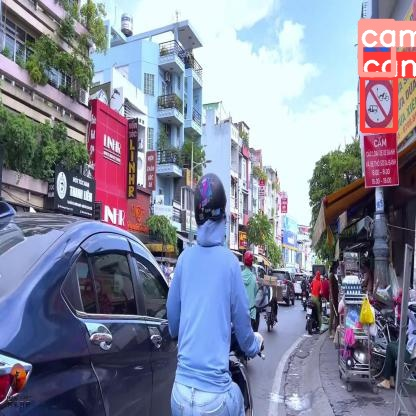

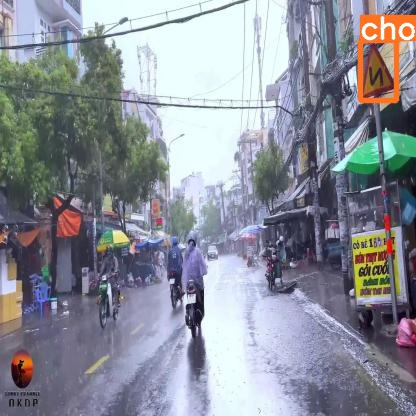

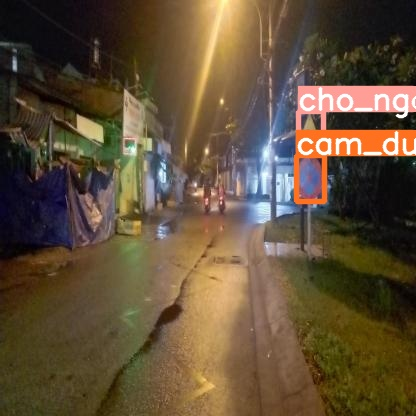

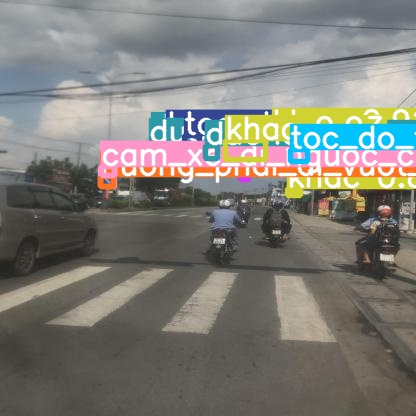

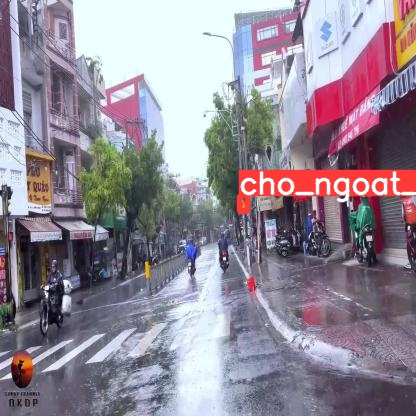

...

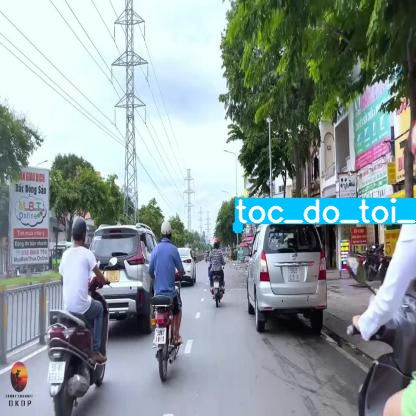

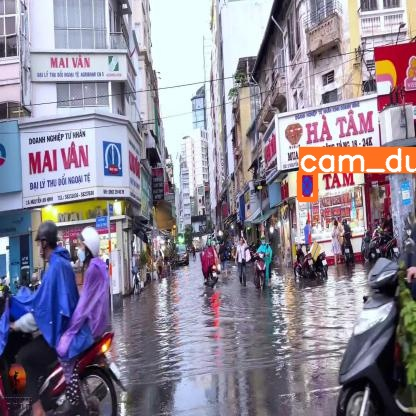

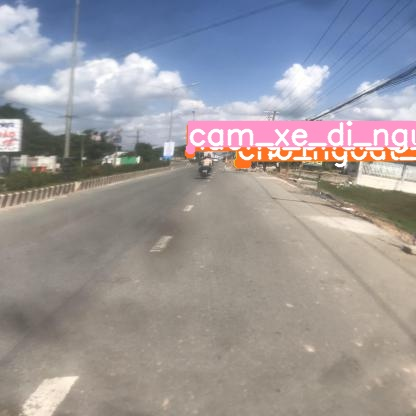

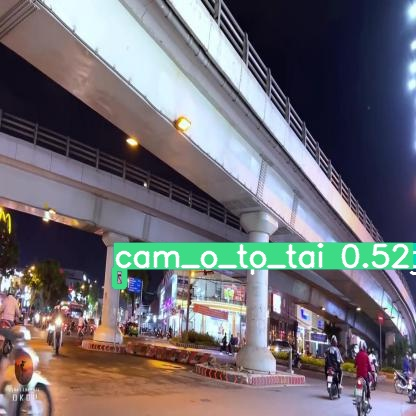

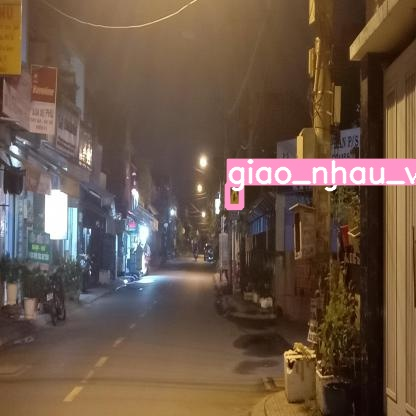

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Conclusion and Next Steps

Congratulations! You've trained a custom YOLOv5 model to recognize your custom objects.

To improve you model's performance, we recommend first interating on your datasets coverage and quality. See this guide for [model performance improvement](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results).

To deploy your model to an application, see this guide on [exporting your model to deployment destinations](https://github.com/ultralytics/yolov5/issues/251).

Once your model is in production, you will want to continually iterate and improve on your dataset and model via [active learning](https://blog.roboflow.com/what-is-active-learning/).

In [ ]:
#export your model's weights for future use
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>